In [5]:
from utils.hparams import hparams
from preprocessing.data_gen_utils import get_pitch_parselmouth,get_pitch_crepe
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import utils
import librosa
import torchcrepe
from infer import *
import logging
from infer_tools.infer_tool import *

logging.getLogger('numba').setLevel(logging.WARNING)

# training에 사용된 프로젝트 폴더 이름 설정 (config 파일에서 설정한 이름)
project_name = "minsu"
model_path = f'./checkpoints/{project_name}/model_ckpt_steps_10000.ckpt' 
config_path=f'./checkpoints/{project_name}/config.yaml'
hubert_gpu=True
svc_model = Svc(project_name,config_path,hubert_gpu, model_path)
print('model loaded')

| load 'model' from './checkpoints/minsu/model_ckpt_steps_10000.ckpt'.
| load 'model' from 'checkpoints/0102_xiaoma_pe/model_ckpt_steps_60000.ckpt'.
| Load HifiGAN:  checkpoints/nsf_hifigan/model
Removing weight norm...
model loaded


In [6]:
wav_fn='raw/afterlike_input.wav' # input audio 파일 경로; 대부분의 오디오 파일 형식 지원함. 굳이 .wav로 변환할 필요 없음.
demoaudio, sr = librosa.load(wav_fn)
key = 0 # pitch 조정 (default)

# speedup rate
pndm_speedup = 10
wav_gen='results/minsu_afterlike_10000_steps.wav'# ouput audio 파일 경로; 다양한 오디오 파일 형식 지원함. (.wav 대신 .flac와 같은 다양한 오디오 파일 형식 O)
f0_tst, f0_pred, audio = run_clip(svc_model,file_path=wav_fn, key=key, acc=pndm_speedup, use_crepe=True, use_pe=True, thre=0.05,
                                        use_gt_mel=False, add_noise_step=500,project_name=project_name,out_path=wav_gen)

code version:2022-12-04
load chunks from temp
#=====segment start, 2.442s======
jump empty segment
#=====segment start, 50.005s======
load temp crepe f0
executing 'get_pitch' costed 0.032s
hubert (on cuda) time used 1.607403039932251


sample time step: 100%|██████████| 100/100 [00:02<00:00, 37.17it/s]


executing 'diff_infer' costed 2.696s
executing 'after_infer' costed 1.541s
#=====segment start, 10.341s======
jump empty segment
#=====segment start, 97.357s======
load temp crepe f0
executing 'get_pitch' costed 0.051s
hubert (on cuda) time used 3.17341947555542


sample time step: 100%|██████████| 100/100 [00:04<00:00, 20.61it/s]


executing 'diff_infer' costed 4.859s
executing 'after_infer' costed 2.986s
#=====segment start, 10.132s======
jump empty segment
#=====segment start, 5.206s======
load temp crepe f0
executing 'get_pitch' costed 0.016s
hubert (on cuda) time used 0.19803404808044434


sample time step: 100%|██████████| 100/100 [00:01<00:00, 92.99it/s]


executing 'diff_infer' costed 1.084s
executing 'after_infer' costed 0.159s
#=====segment start, 1.483s======
jump empty segment


In [7]:
ipd.display(ipd.Audio(demoaudio, rate=sr))
ipd.display(ipd.Audio(audio, rate=hparams['audio_sample_rate'], normalize=True))

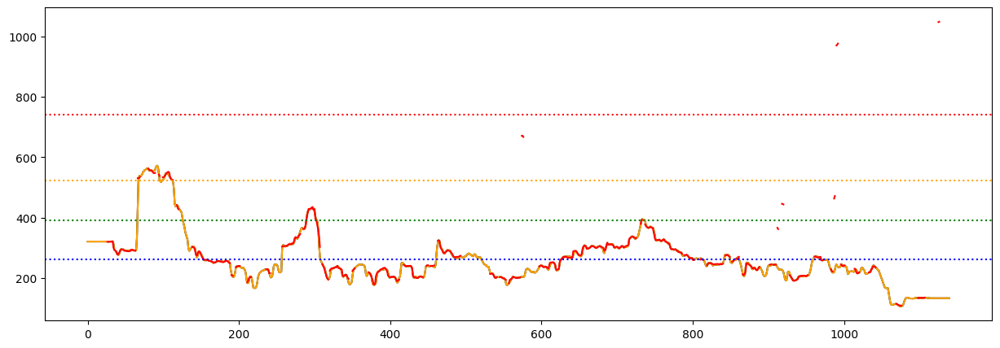

In [8]:
#f0_gen,_=get_pitch_crepe(*vocoder.wav2spec(wav_gen),hparams,threshold=0.05)
%matplotlib inline
f0_gen,_=get_pitch_parselmouth(*svc_model.vocoder.wav2spec(wav_gen),hparams)
f0_tst[f0_tst==0]=np.nan#ground truth f0
f0_pred[f0_pred==0]=np.nan#f0 pe predicted
f0_gen[f0_gen==0]=np.nan#f0 generated
fig=plt.figure(figsize=[15,5])
plt.plot(np.arange(0,len(f0_tst)),f0_tst,color='black')
plt.plot(np.arange(0,len(f0_pred)),f0_pred,color='orange')
plt.plot(np.arange(0,len(f0_gen)),f0_gen,color='red')
plt.axhline(librosa.note_to_hz('C4'),ls=":",c="blue")
plt.axhline(librosa.note_to_hz('G4'),ls=":",c="green")
plt.axhline(librosa.note_to_hz('C5'),ls=":",c="orange")
plt.axhline(librosa.note_to_hz('F#5'),ls=":",c="red")
#plt.axhline(librosa.note_to_hz('A#5'),ls=":",c="black")
plt.show()